In [1]:
import random

import torch
from torch import nn
import torch.nn.functional as F
import torch.distributed as dist

from tqdm import tqdm
from torchvision import transforms as T
import torchvision

In [2]:
from byol_pytorch import BYOL

resnet_path = './improved-net-2.pt'
learner_path = './learner-net-2.pt'

In [3]:
resnet = torchvision.models.resnet50(pretrained=True)
device = 'cuda'
resnet = resnet.to(device)

learner = BYOL(
    resnet,
    image_size = 256,
    hidden_layer = 'avgpool',
    use_momentum=False
)

opt = torch.optim.Adam(learner.parameters(), lr=3e-4)

/home/avm6288/.local/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/avm6288/.local/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [4]:
resnet.load_state_dict(torch.load(resnet_path))
learner.load_state_dict(torch.load(learner_path))

<All keys matched successfully>

In [5]:
def set_requires_grad(model, requires_grad=False):
    for param in model.parameters():
        param.requires_grad = requires_grad

In [6]:
learner.eval()
resnet.eval()
set_requires_grad(learner, False)
set_requires_grad(resnet, False)

## Data Loading

for name in torch.load('./learner-net-2.pt').keys():
    if name.startswith('online_predictor'):
        print(name)

In [7]:
import torchvision

# img_path = "dataset/style/artbench-10-imagefolder-split/"
img_path = "dataset/style_final"

data_transform = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor(),
    # T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_style = torchvision.datasets.ImageFolder(root=img_path, transform=data_transform)
# test_style  = torchvision.datasets.ImageFolder(root=img_path+"test", transform=data_transform)

In [8]:
for img, l in train_style:
    print(img.shape)
    break

torch.Size([3, 256, 256])


In [9]:
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, content_dataset, style_dataset):
        self.content_dataset = content_dataset
        self.style_dataset = style_dataset

    def __len__(self):
        return min(len(self.content_dataset), len(self.style_dataset))

    def __getitem__(self, idx):
        content_img, _ = self.content_dataset[idx]
        style_img, _ = self.style_dataset[idx]

        return content_img, style_img

In [10]:
data_transform = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor(),
    # T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_content = torchvision.datasets.OxfordIIITPet(root='petdataset', split='trainval', download=True,  transform=data_transform)
# test_content = torchvision.datasets.OxfordIIITPet(root='petdataset', split='test', download=True,  transform=data_transform)

In [11]:
for img, l in train_content:
    print(img.shape)
    break

torch.Size([3, 256, 256])


In [12]:
train_ds = CustomDataset(train_content, train_style)
# test_ds = CustomDataset(test_content, test_style)

In [13]:
BATCH_SIZE = 64

train_dl =  torch.utils.data.DataLoader(dataset=train_ds, batch_size=BATCH_SIZE, shuffle=True)
# test_dl =  torch.utils.data.DataLoader(dataset=test_ds, batch_size=BATCH_SIZE, shuffle=False)

In [14]:
for content, style in train_dl:
    print(content.shape, style.shape)
    break

torch.Size([18, 3, 256, 256]) torch.Size([18, 3, 256, 256])


## Models

In [15]:
import torch
from torch import nn

In [16]:
class AdaIN(nn.Module):
    def __init__(self, channels, style_dim=256):
        super(AdaIN, self).__init__()
        self.instance_norm = nn.InstanceNorm2d(channels, affine=False)
        self.style_scale_transform = nn.Linear(style_dim, channels)
        self.style_shift_transform = nn.Linear(style_dim, channels)

    def forward(self, content, style):
        normalized_content = self.instance_norm(content)
        style_scale = self.style_scale_transform(style).unsqueeze(2).unsqueeze(3)
        style_shift = self.style_shift_transform(style).unsqueeze(2).unsqueeze(3)
        # print("ADAIN:")
        # print(style_scale.shape, style_shift.shape)
        # print(normalized_content.shape)
        transformed_content = style_scale * normalized_content + style_shift
        return transformed_content

In [17]:
class ShapePrint(nn.Module):
    def __init__(self):
        super(ShapePrint, self).__init__()
    def forward(self, x):
        print(x.shape)
        return x

In [18]:
class UNet(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=0, learner=learner):
        super(UNet, self).__init__()

        self.enc1 = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=5),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 64, kernel_size=5),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

        self.enc2 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=5),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=5),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

        self.enc3 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=5),
            # ShapePrint(),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=5),
            # ShapePrint(),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout),
            nn.MaxPool2d(kernel_size=2, stride=2),
            # ShapePrint(),
        )
        
        self.dec1 = nn.Sequential(
            nn.Upsample(size = (58, 58), mode='bilinear', align_corners=True),
            # ShapePrint(),
            nn.Conv2d(256, 256, kernel_size=5, padding=2),
            # ShapePrint(),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 128, kernel_size=5, padding=2),
            # ShapePrint(),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout)
        )

        self.dec2 = nn.Sequential(
            nn.Upsample(size = (124, 124), mode='bilinear', align_corners=True),
            nn.Conv2d(128, 128, kernel_size=5, padding=2),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 64, kernel_size=5, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout)
        )

        self.dec3 = nn.Sequential(
            nn.Upsample(size = (256, 256), mode='bilinear', align_corners=True),
            nn.Conv2d(64, 64, kernel_size=5, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 32, kernel_size=5, padding=2),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, out_channels, kernel_size=5, padding=2)
        )

        self.inp_exp = nn.Conv2d(in_channels, out_channels, kernel_size=1)

        self.AdaIN_1 = AdaIN(128, 256)
        self.AdaIN_2 = AdaIN(64, 256)
        self.AdaIN_3 = AdaIN(3, 256)

        self.style_encoder = learner
        self.style_encoder.eval()
        set_requires_grad(learner, False)

    def forward(self, x, style):
        a1 = self.enc1(x)
        a2 = self.enc2(a1)
        a3 = self.enc3(a2)
        # a3 = a3
        # print(a1.shape, a2.shape, a3.shape)
        style = self.style_encoder(style, return_embedding = True)
        # style = torch.rand((BATCH_SIZE, 256))
        style = style[0]
        # print(style.shape)
        b1 = self.dec1(a3) + self.AdaIN_1(a2, style)
        b2 = self.dec2(b1) + self.AdaIN_2(a1, style)
        b3 = self.dec3(b2) + self.AdaIN_3(self.inp_exp(x), style)
        # print(b3.shape)
        return b3

In [19]:
def content_loss(content_image, output_image, model, loss_fn):
    content_features = model(content_image)['content']
    output_features = model(output_image)['content']
    
    content_loss = loss_fn(output_features, content_features.detach())
    
    return content_loss

In [20]:
def style_loss(style_image, output_image, model, loss_fn, learner=learner):
    style_ft = model(style_image)
    output_ft = model(output_image)
    
    style_features = style_ft['style1']
    output_features = output_ft['style1']
    style_loss1 = loss_fn(output_features, style_features.detach())

    style_features = style_ft['style2']
    output_features = output_ft['style2']
    style_loss2 = loss_fn(output_features, style_features.detach())

    style_features = style_ft['style3']
    output_features = output_ft['style3']
    style_loss3 = loss_fn(output_features, style_features.detach())

    style_features = style_ft['style4']
    output_features = output_ft['style4']
    style_loss4 = loss_fn(output_features, style_features.detach())


    style_features = style_ft['style5']
    output_features = output_ft['style5']
    style_loss5 = loss_fn(output_features, style_features.detach())

    style_embeddings = learner(style_image, return_embedding = True)[0]
    output_embeddings = learner(output_image, return_embedding = True)[0]
    # print(style_ft.keys())
    style_loss6 = loss_fn(output_embeddings, style_embeddings.detach())
    
    return (style_loss1 + style_loss2 + style_loss3 + style_loss4 + style_loss5 + 2*style_loss6)/6

In [21]:
from torchvision.models.feature_extraction import create_feature_extractor

content_loss_model = torchvision.models.resnet50(pretrained=True).to('cuda')
content_loss_model.eval()
set_requires_grad(content_loss_model, False)
content_feature_extractor = create_feature_extractor(content_loss_model, return_nodes = {'layer4': 'content'})


style_loss_model = learner.online_encoder.net
style_loss_model.eval()
set_requires_grad(style_loss_model, False)
# ['conv1', 'layer1', 'layer2', 'layer3', 'layer4']
style_feature_extractor = create_feature_extractor(style_loss_model, return_nodes = {'conv1': 'style1', 'layer1':'style2', 'layer2':'style3', 'layer3':'style4', 'layer4':'style5'})


loss_fn    = F.mse_loss

In [22]:
model = UNet(3, 3, 0)
device = 'cuda'
model = model.to(device)
opt = torch.optim.Adam(model.parameters(), lr=3e-4)

In [23]:
# model.load_state_dict(torch.load('./results/old_encoder/models/style_unet_state_dict_5000.pth'))

# for epoch in range(1):
#     for Ic, Is in train_dl:
#         Ic, Is = Ic.to(device), Is.to(device)
#         O = model(Ic, Is)
        
#         Lc = content_loss(Ic, O, content_feature_extractor, loss_fn)
#         Ls = style_loss(Is, O, style_feature_extractor, loss_fn)

#         plot_style_transfer(Ic.cpu().detach(), Is.cpu().detach(), O.cpu().detach(), epoch, base_name="./results/temp/", batch_size=18)

In [24]:
epochs = 500
L_total = 0

In [25]:
import matplotlib.pyplot as plt

def plot_style_transfer(Ic, Is, O, epoch, base_name, batch_size = 2):
    
    fig, axes = plt.subplots(batch_size, 3, figsize=(15, 5 * batch_size))
    
    for i in range(batch_size):
        axes[i, 0].imshow(Ic[i].permute(1, 2, 0))
        axes[i, 0].set_title(f'Ic - Image {i+1}')
        axes[i, 0].axis('off')
        
        axes[i, 1].imshow(Is[i].permute(1, 2, 0))
        axes[i, 1].set_title(f'Is - Style {i+1}')
        axes[i, 1].axis('off')
        
        axes[i, 2].imshow(O[i].permute(1, 2, 0))
        axes[i, 2].set_title(f'O - Output {i+1}')
        axes[i, 2].axis('off')
        
    plt.tight_layout()
    # Save the figure
    plt.savefig('{}{}.png'.format(base_name, epoch))
    plt.show()


In [26]:
base_name="./results/old_encoder_changed_style_texture_loss/"
import os
try:
    os.mkdir(base_name)
except:
    pass

try:
    os.mkdir(base_name+"models/")
except:
    pass

Epoch 0/100 L = 0: 100%|██████████| 1/1 [00:13<00:00, 13.76s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.767729640007019/6.955522060394287


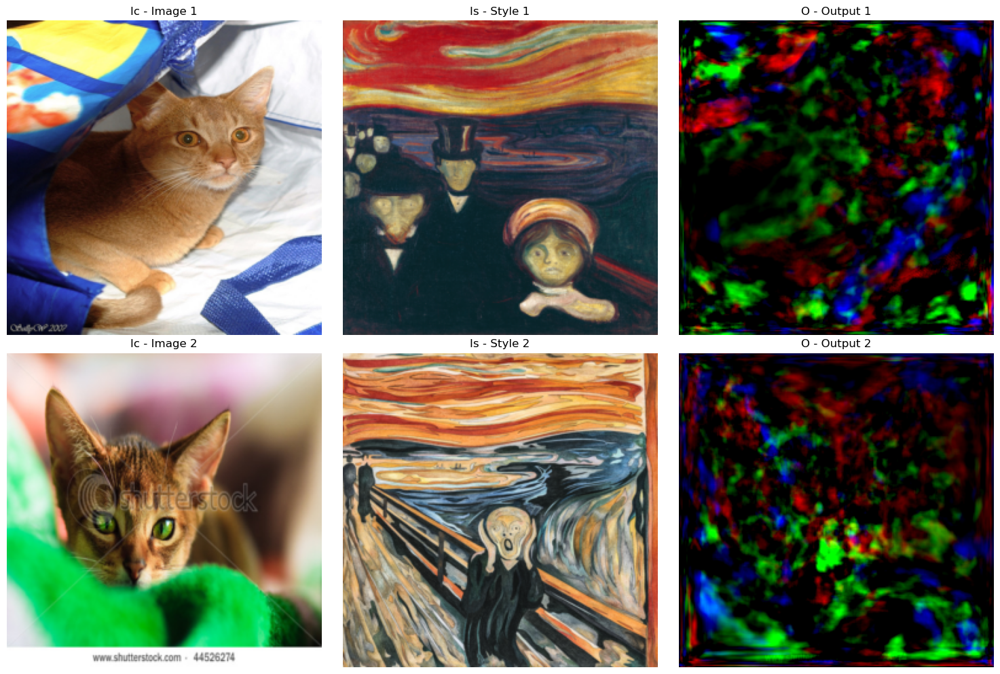

Epoch 5/100 L = 4.597580432891846: 100%|██████████| 1/1 [00:09<00:00,  9.76s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.6224973797798157/1.0015169382095337


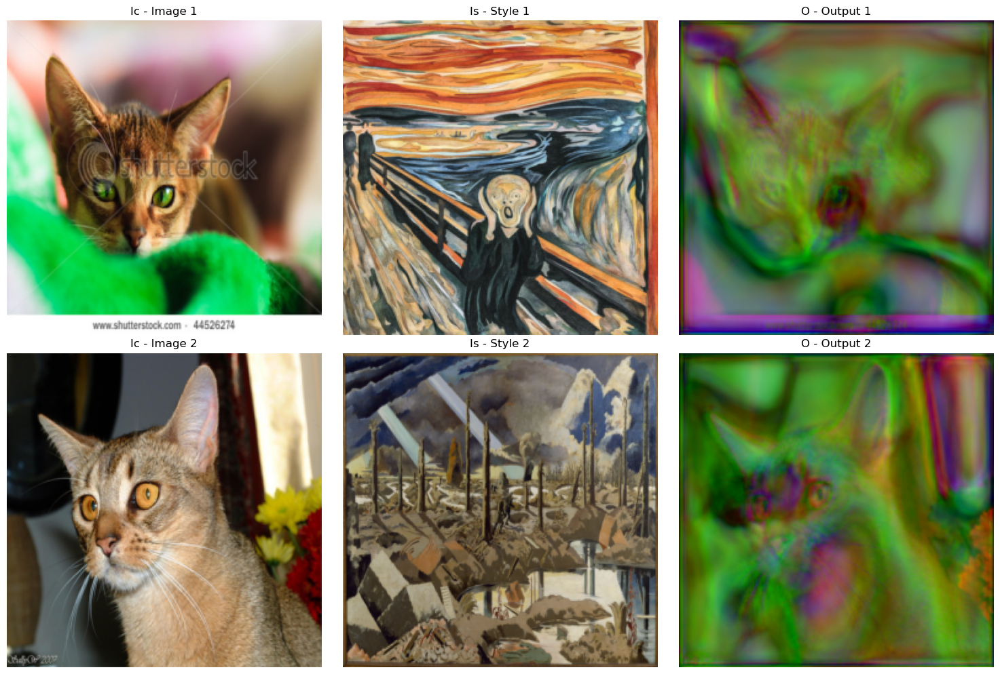

Epoch 10/100 L = 3.4450807571411133: 100%|██████████| 1/1 [00:09<00:00,  9.87s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.49681493639945984/0.82890784740448


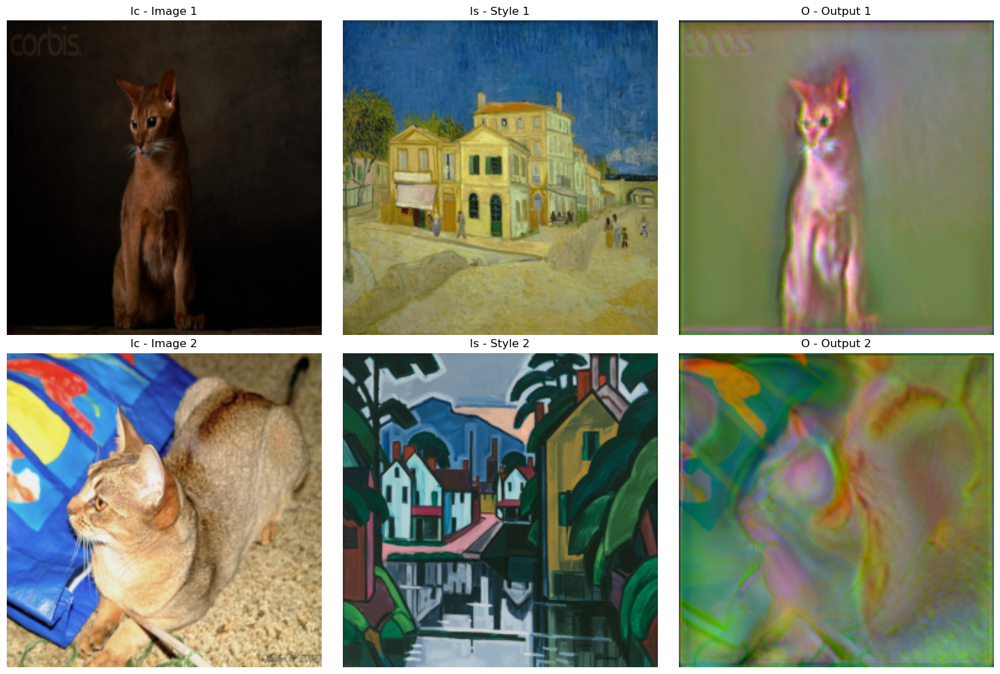

Epoch 15/100 L = 2.666428565979004: 100%|██████████| 1/1 [00:09<00:00,  9.93s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.3385489881038666/0.8260387182235718


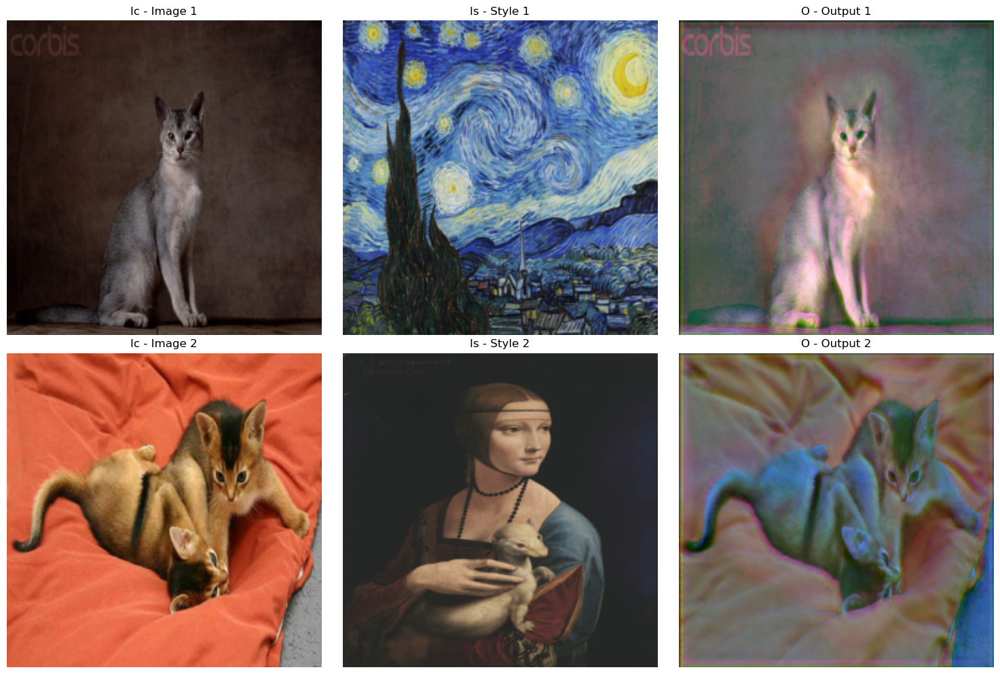

Epoch 20/100 L = 2.0815277099609375: 100%|██████████| 1/1 [00:09<00:00,  9.84s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.22672833502292633/0.8639182448387146


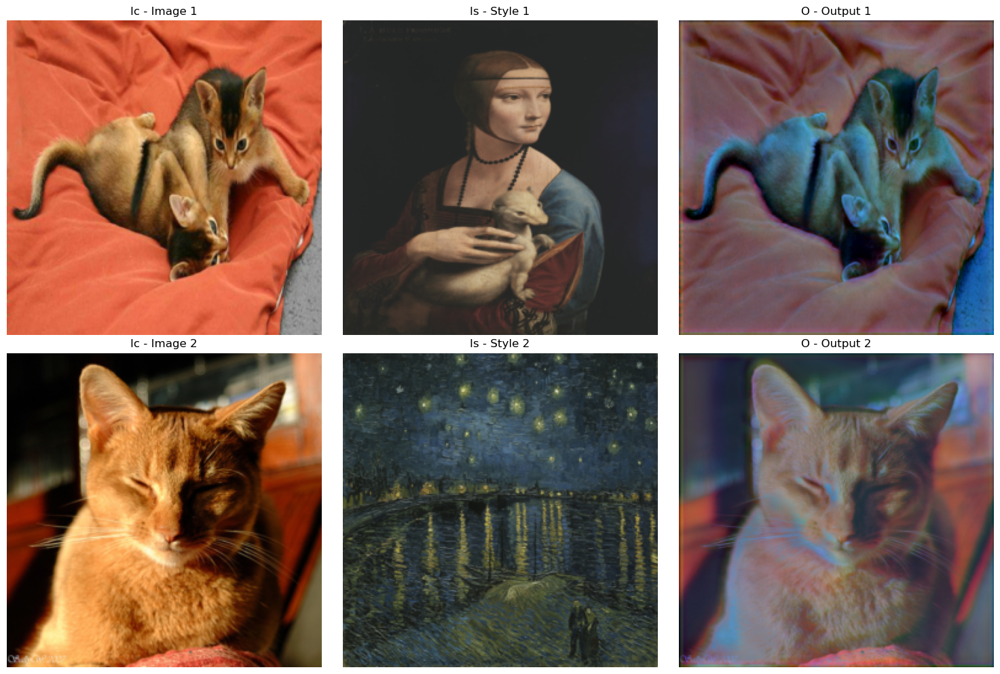

Epoch 25/100 L = 1.743109941482544: 100%|██████████| 1/1 [00:09<00:00,  9.77s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.17031820118427277/0.8525985479354858


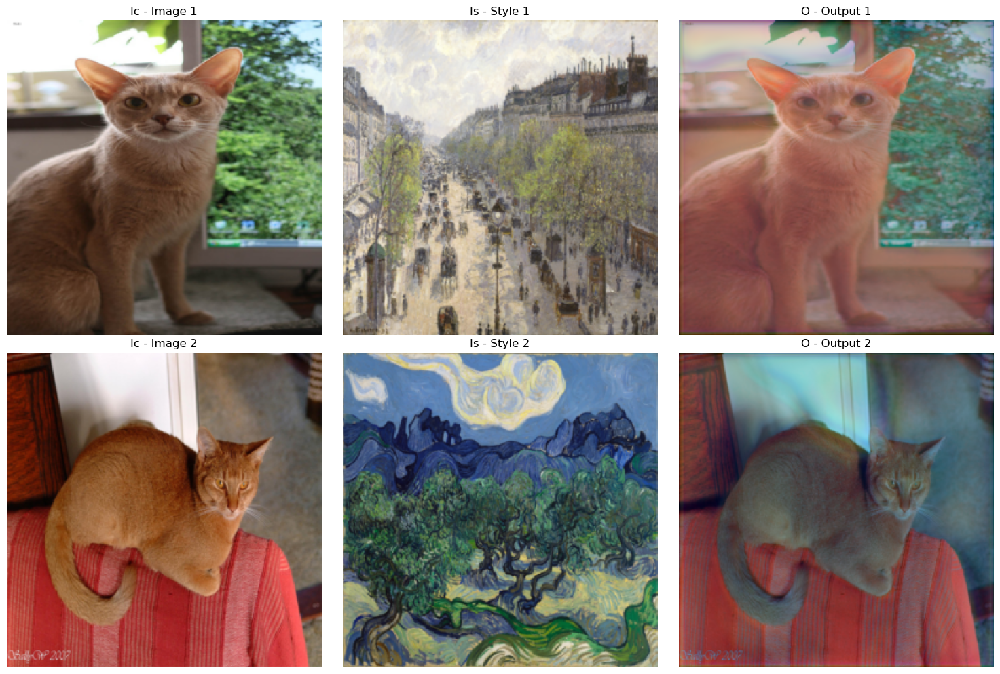

Epoch 30/100 L = 1.5624829530715942: 100%|██████████| 1/1 [00:09<00:00,  9.89s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.14855286478996277/0.7922918796539307


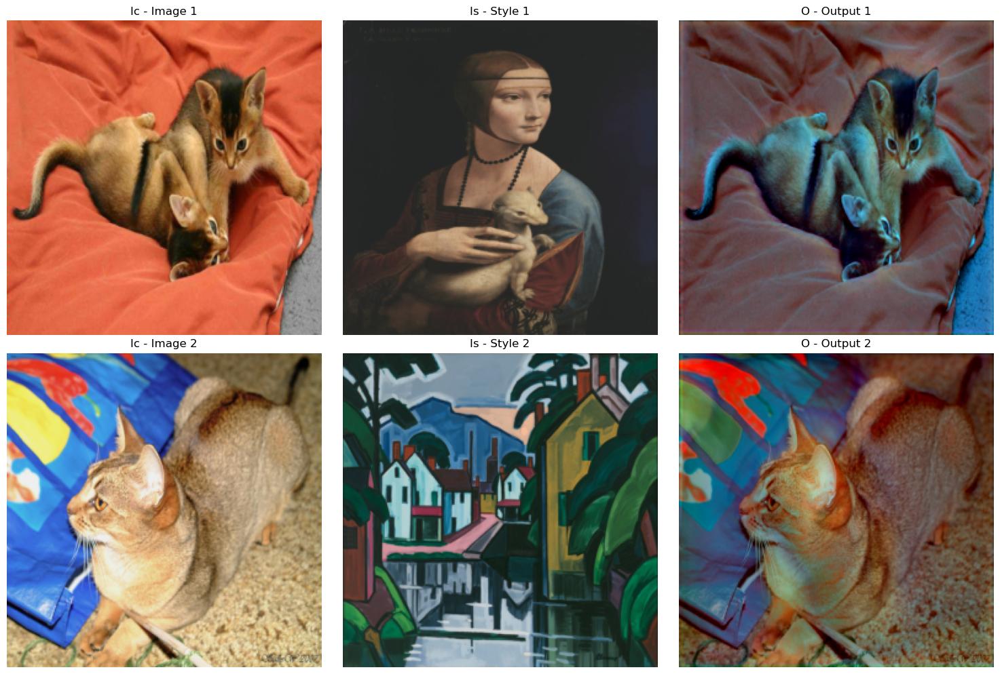

Epoch 35/100 L = 1.4240076541900635: 100%|██████████| 1/1 [00:09<00:00,  9.76s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.1321999877691269/0.7382347583770752


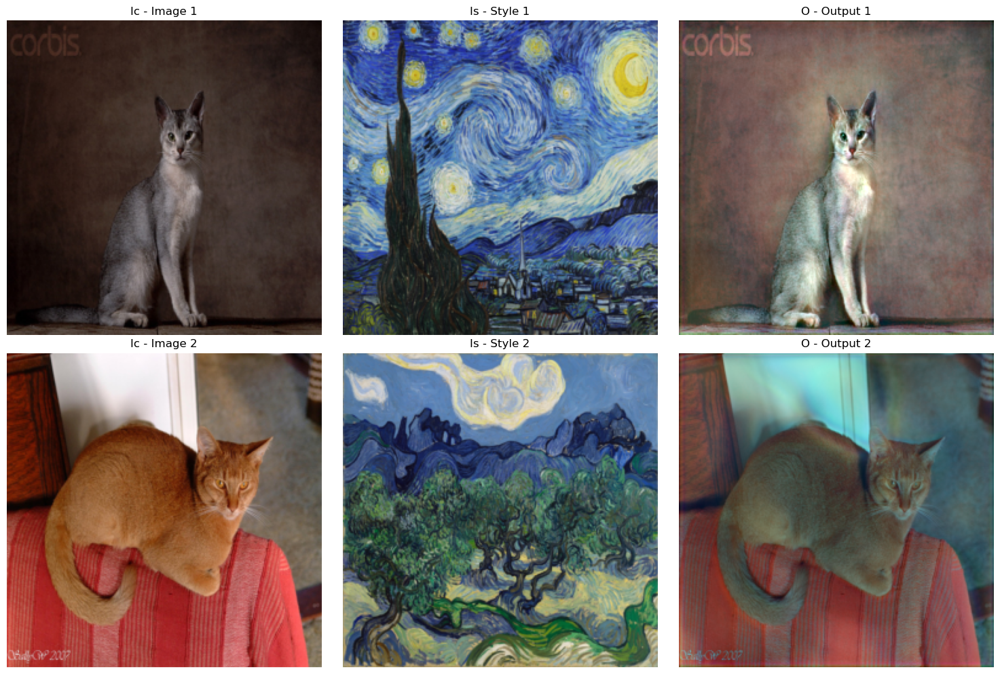

Epoch 40/100 L = 1.312330722808838: 100%|██████████| 1/1 [00:09<00:00,  9.78s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.12055306881666183/0.6881983280181885


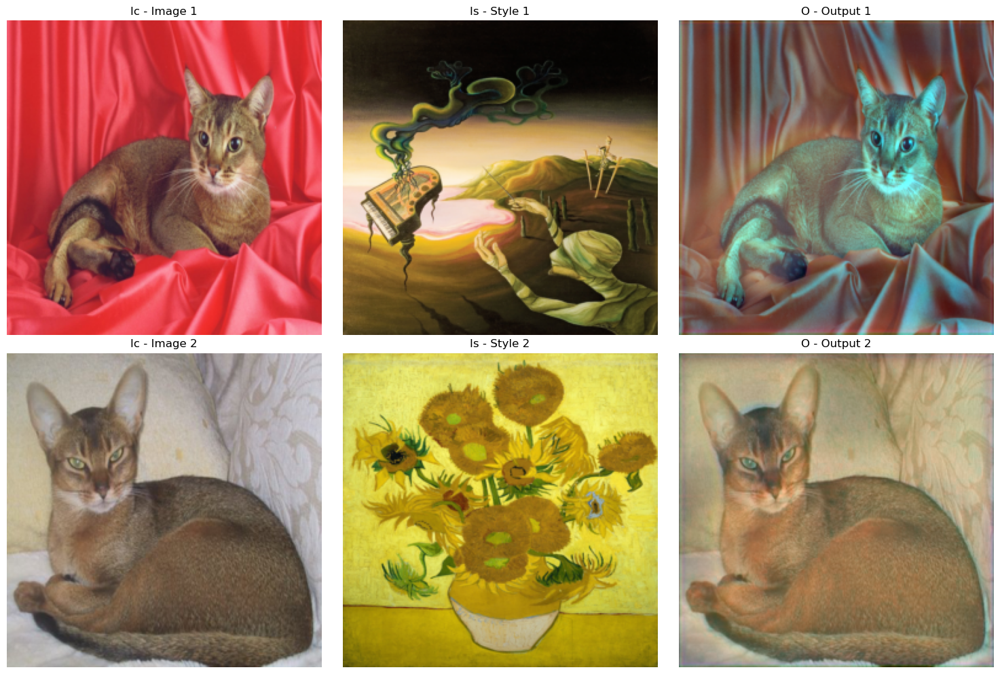

Epoch 45/100 L = 1.2155852317810059: 100%|██████████| 1/1 [00:09<00:00,  9.87s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Content/Style: 0.11029057949781418/0.6487411260604858


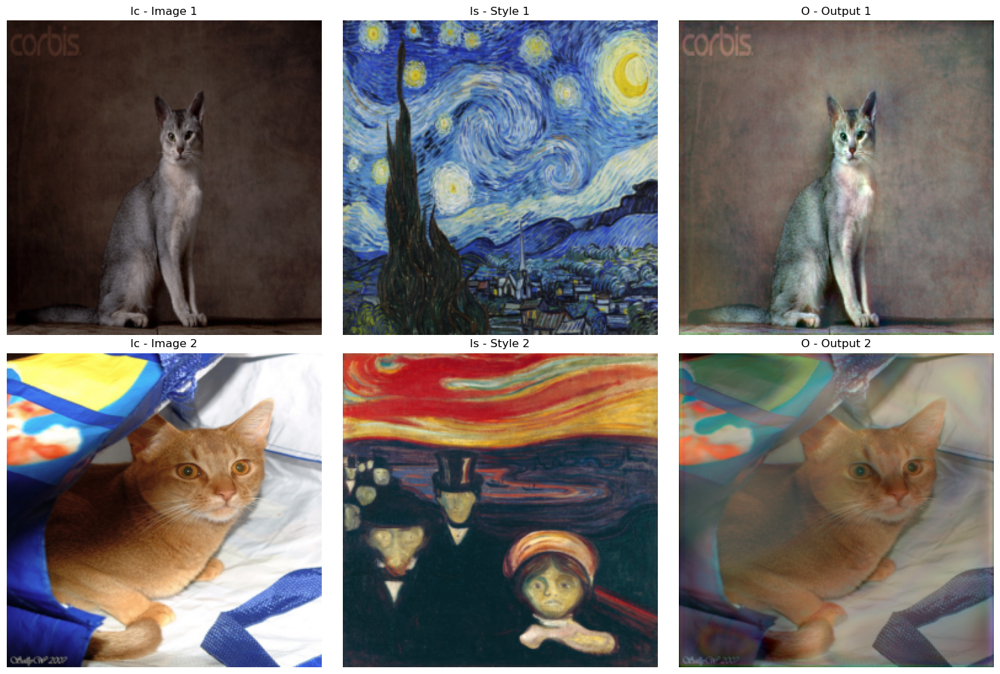

Epoch 99/100 L = 0.7454854249954224: 100%|██████████| 1/1 [00:09<00:00,  9.89s/it]


In [27]:
LCs = []
LSs = []
LTs = []

epochs = 100

for epoch in range(epochs):
    for Ic, Is in tqdm(train_dl, desc=f'Epoch {epoch}/{epochs} L = {L_total}', leave=True):
        Ic, Is = Ic.to(device), Is.to(device)
        O = model(Ic, Is)
        
        Lc = content_loss(Ic, O, content_feature_extractor, loss_fn)
        Ls = style_loss(Is, O, style_feature_extractor, loss_fn)
        #Lt = content_loss(Is, O, content_feature_extractor, loss_fn)
        LCs.append(Lc.item())
        LSs.append(Ls.item())
        L_total = 5*Lc + Ls #+ 0.05*Lt
        LTs.append(L_total.item())
        L_total.backward()
        opt.step()
        opt.zero_grad()
    if epoch % 100 == 0 or (epoch % 5 == 0 and epoch < 50):
        print("Content/Style: {}/{}".format(Lc.item(), Ls.item()))
        plot_style_transfer(Ic.cpu().detach(), Is.cpu().detach(), O.cpu().detach(), epoch, base_name)
        torch.save(model, '{}style_unet_{}.pth'.format(base_name+"models/", epochs))
        torch.save(model.state_dict(), '{}style_unet_state_dict_{}.pth'.format(base_name+"models/", epochs))

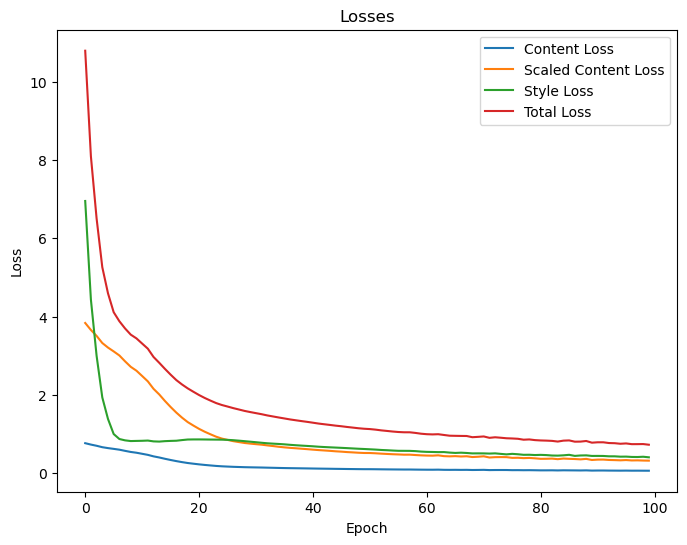

In [31]:
import matplotlib.pyplot as plt

# Assuming LCs, LSs, and LTs are defined somewhere

# Plotting LCs, LSs, and LTs in the same plot
plt.figure(figsize=(8, 6))
lc_ = [5*l for l in LCs]

plt.plot(LCs, label='Content Loss')
plt.plot(lc_, label='Scaled Content Loss')
plt.plot(LSs, label='Style Loss')
plt.plot(LTs, label='Total Loss')

plt.title('Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.savefig('losses_combined.png')
plt.show()


In [ ]:
torch.save(model, '{}style_unet_final{}.pth'.format(base_name+"models/", epochs))

In [ ]:
torch.save(model.state_dict(), '{}style_unet_state_dict_final_{}.pth'.format(base_name+"models/", epochs))

In [ ]:
print("Content/Style: {}/{}".format(Lc.item(), Ls.item()))
plot_style_transfer(Ic.cpu().detach(), Is.cpu().detach(), O.cpu().detach(), epoch, base_name)

# DDPM

In [ ]:
# Import of libraries
import random
import imageio
import numpy as np
from argparse import ArgumentParser

from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import einops
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader

import torchvision

import torchvision.transforms as T
from torchvision.datasets.mnist import MNIST, FashionMNIST

# Setting reproducibility
SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

# Import of libraries
import random
import imageio
import numpy as np
from argparse import ArgumentParser

from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import einops
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader

import torchvision

import torchvision.transforms as T
from torchvision.datasets.mnist import MNIST, FashionMNIST

# Setting reproducibility
SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

In [ ]:
no_train = True
batch_size = 64
n_epochs = 20
lr = 0.001

store_path = "./ddpm/ddpm_trained.pt"

In [ ]:
# Getting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}\t" + (f"{torch.cuda.get_device_name(0)}" if torch.cuda.is_available() else "CPU"))

In [ ]:
# DDPM class
class MyDDPM(nn.Module):
    def __init__(self, network, n_steps=200, min_beta=10 ** -4, max_beta=0.02, device=None, image_chw=(1, 28, 28)):
        super(MyDDPM, self).__init__()
        self.n_steps = n_steps
        self.device = device
        self.image_chw = image_chw
        self.network = network.to(device)
        self.betas = torch.linspace(min_beta, max_beta, n_steps).to(
            device)  # Number of steps is typically in the order of thousands
        self.alphas = 1 - self.betas
        self.alpha_bars = torch.tensor([torch.prod(self.alphas[:i + 1]) for i in range(len(self.alphas))]).to(device)

    def forward(self, x0, t, eta=None):
        # Make input image more noisy (we can directly skip to the desired step)
        n, c, h, w = x0.shape
        a_bar = self.alpha_bars[t]

        if eta is None:
            eta = torch.randn(n, c, h, w).to(self.device)

        noisy = a_bar.sqrt().reshape(n, 1, 1, 1) * x0 + (1 - a_bar).sqrt().reshape(n, 1, 1, 1) * eta
        return noisy

    def backward(self, x, t):
        # Run each image through the network for each timestep t in the vector t.
        # The network returns its estimation of the noise that was added.
        return self.network(x, t)

In [ ]:
def sinusoidal_embedding(n, d):
    # Returns the standard positional embedding
    embedding = torch.zeros(n, d)
    wk = torch.tensor([1 / 10_000 ** (2 * j / d) for j in range(d)])
    wk = wk.reshape((1, d))
    t = torch.arange(n).reshape((n, 1))
    embedding[:,::2] = torch.sin(t * wk[:,::2])
    embedding[:,1::2] = torch.cos(t * wk[:,::2])

    return embedding

In [ ]:
class MyBlock(nn.Module):
    def __init__(self, shape, in_c, out_c, kernel_size=3, stride=1, padding=1, activation=None, normalize=True):
        super(MyBlock, self).__init__()
        self.ln = nn.LayerNorm(shape)
        self.conv1 = nn.Conv2d(in_c, out_c, kernel_size, stride, padding)
        self.conv2 = nn.Conv2d(out_c, out_c, kernel_size, stride, padding)
        self.activation = nn.SiLU() if activation is None else activation
        self.normalize = normalize

    def forward(self, x):
        out = self.ln(x) if self.normalize else x
        out = self.conv1(out)
        out = self.activation(out)
        out = self.conv2(out)
        out = self.activation(out)
        return out

In [ ]:
class MyUNet(nn.Module):
    def __init__(self, n_steps=1000, time_emb_dim=100):
        super(MyUNet, self).__init__()

        # Sinusoidal embedding
        self.time_embed = nn.Embedding(n_steps, time_emb_dim)
        self.time_embed.weight.data = sinusoidal_embedding(n_steps, time_emb_dim)
        self.time_embed.requires_grad_(False)
        initial_layers = 16
        # First half
        self.te1 = self._make_te(time_emb_dim, 1)
        # shape, in_c, out_c, kernel_size=3, stride=1, padding=1, activation=None
        self.b1 = nn.Sequential(
            MyBlock((3, 256, 256), 3, initial_layers),
            MyBlock((initial_layers, 256, 256), initial_layers, initial_layers),
            MyBlock((initial_layers, 256, 256), initial_layers, initial_layers)
        )
        self.down1 = nn.Conv2d(initial_layers, initial_layers, 4, 2, 1)

        self.te2 = self._make_te(time_emb_dim, initial_layers)
        self.b2 = nn.Sequential(
            MyBlock((initial_layers, 128, 128), initial_layers, 2*initial_layers),
            MyBlock((2*initial_layers, 128, 128), 2*initial_layers, 2*initial_layers),
            MyBlock((2*initial_layers, 128, 128), 2*initial_layers, 2*initial_layers)
        )
        self.down2 = nn.Conv2d(2*initial_layers, 2*initial_layers, 4, 2, 1)

        self.te3 = self._make_te(time_emb_dim, 2*initial_layers)
        self.b3 = nn.Sequential(
            MyBlock((2*initial_layers, 64, 64), 2*initial_layers, 4*initial_layers),
            MyBlock((4*initial_layers, 64, 64), 4*initial_layers, 4*initial_layers),
            MyBlock((4*initial_layers, 64, 64), 4*initial_layers, 4*initial_layers)
        )
        self.down3 = nn.Sequential(
            # nn.Conv2d(4*initial_layers, 4*initial_layers, 2, 1),
            # nn.SiLU(),
            nn.Conv2d(4*initial_layers, 4*initial_layers, 4, 2, 1)
        )

        # Bottleneck
        self.te_mid = self._make_te(time_emb_dim, 4*initial_layers)
        self.b_mid = nn.Sequential(
            MyBlock((4*initial_layers, 32, 32), 4*initial_layers, 2*initial_layers),
            MyBlock((2*initial_layers, 32, 32), 2*initial_layers, 2*initial_layers),
            MyBlock((2*initial_layers, 32, 32), 2*initial_layers, 4*initial_layers)
        )

        # 4*initial_layersSecond half
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(4*initial_layers, 4*initial_layers, 4, 2, 1),
            # nn.SiLU(),
            # nn.ConvTranspose2d(4*initial_layers,4*initial_layers, 2, 1)
        )

        self.te4 = self._make_te(time_emb_dim, 8*initial_layers)
        self.b4 = nn.Sequential(
            MyBlock((8*initial_layers, 64, 64), 8*initial_layers, 4*initial_layers),
            MyBlock((4*initial_layers, 64, 64), 4*initial_layers, 2*initial_layers),
            MyBlock((2*initial_layers, 64, 64), 2*initial_layers, 2*initial_layers)
        )

        self.up2 = nn.ConvTranspose2d(2*initial_layers, 2*initial_layers, 4, 2, 1)
        self.te5 = self._make_te(time_emb_dim, 4*initial_layers)
        self.b5 = nn.Sequential(
            MyBlock((4*initial_layers, 128, 128), 4*initial_layers, 2*initial_layers),
            MyBlock((2*initial_layers, 128, 128), 2*initial_layers, initial_layers),
            MyBlock((initial_layers, 128, 128), initial_layers, initial_layers)
        )

        self.up3 = nn.ConvTranspose2d(initial_layers, initial_layers, 4, 2, 1)
        self.te_out = self._make_te(time_emb_dim, 2*initial_layers)
        self.b_out = nn.Sequential(
            MyBlock((2*initial_layers, 256, 256), 2*initial_layers, initial_layers),
            MyBlock((initial_layers, 256, 256), initial_layers, initial_layers),
            MyBlock((initial_layers, 256, 256), initial_layers, initial_layers, normalize=False)
        )

        self.conv_out = nn.Conv2d(initial_layers, 3, 3, 1, 1)

    def forward(self, x, t):
        # x is (N, 2, 28, 28) (image with positional embedding stacked on channel dimension)
        t = self.time_embed(t)
        n = len(x)
        out1 = self.b1(x + self.te1(t).reshape(n, -1, 1, 1))  # (N, 10, 28, 28)
        
        out2 = self.b2(self.down1(out1) + self.te2(t).reshape(n, -1, 1, 1))  # (N, 20, 14, 14)
        out3 = self.b3(self.down2(out2) + self.te3(t).reshape(n, -1, 1, 1))  # (N, 40, 7, 7)
        # print(self.down3(out3).shape, self.te_mid(t).reshape(n, -1, 1, 1).shape)
        out_mid = self.b_mid(self.down3(out3) + self.te_mid(t).reshape(n, -1, 1, 1))  # (N, 40, 3, 3)

        # print(out3.shape, self.up1(out_mid).shape)
        out4 = torch.cat((out3, self.up1(out_mid)), dim=1)  # (N, 80, 7, 7)
        out4 = self.b4(out4 + self.te4(t).reshape(n, -1, 1, 1))  # (N, 20, 7, 7)

        out5 = torch.cat((out2, self.up2(out4)), dim=1)  # (N, 40, 14, 14)
        out5 = self.b5(out5 + self.te5(t).reshape(n, -1, 1, 1))  # (N, 10, 14, 14)

        out = torch.cat((out1, self.up3(out5)), dim=1)  # (N, 20, 28, 28)
        out = self.b_out(out + self.te_out(t).reshape(n, -1, 1, 1))  # (N, 1, 28, 28)

        out = self.conv_out(out)

        return out

    def _make_te(self, dim_in, dim_out):
        return nn.Sequential(
            nn.Linear(dim_in, dim_out),
            nn.SiLU(),
            nn.Linear(dim_out, dim_out)
        )

In [ ]:
# Defining model
n_steps, min_beta, max_beta = 1000, 10 ** -4, 0.02  # Originally used by the authors
ddpm = MyDDPM(MyUNet(n_steps), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

In [ ]:
# Loading the trained model
ddpm = MyDDPM(MyUNet(), n_steps=n_steps, device=device)
ddpm.load_state_dict(torch.load(store_path, map_location=device))
ddpm.eval()
print("Model loaded")

In [ ]:
x = O.detach().to(device)
n_samples = 18
t = 45
c = 3
h = 256
w = 256

time_tensor = (torch.ones(n_samples, 1) * t).to(device).long()
eta_theta = ddpm.backward(x, time_tensor)

alpha_t = ddpm.alphas[t]
alpha_t_bar = ddpm.alpha_bars[t]

# Partially denoising the image
x = (1 / alpha_t.sqrt()) * (x - (1 - alpha_t) / (1 - alpha_t_bar).sqrt() * eta_theta)

if t > 0:
    z = torch.randn(n_samples, c, h, w).to(device)

    # Option 1: sigma_t squared = beta_t
    beta_t = ddpm.betas[t]
    sigma_t = beta_t.sqrt()

    # Option 2: sigma_t squared = beta_tilda_t
    # prev_alpha_t_bar = ddpm.alpha_bars[t-1] if t > 0 else ddpm.alphas[0]
    # beta_tilda_t = ((1 - prev_alpha_t_bar)/(1 - alpha_t_bar)) * beta_t
    # sigma_t = beta_tilda_t.sqrt()

    # Adding some more noise like in Langevin Dynamics fashion
    x = x + sigma_t * z


In [ ]:
plot_style_transfer(Ic.cpu().detach(), Is.cpu().detach(), O.cpu().detach(), epoch, base_name, batch_size=18)

In [ ]:
plot_style_transfer(Ic.cpu().detach(), Is.cpu().detach(), x.cpu().detach(), epoch, base_name, batch_size=18)

In [ ]:
from skimage.metrics import structural_similarity as ssim_sk

# def ssim(image1, image2):
#     image1 = image1.permute(0, 2, 3, 1).cpu().numpy()
#     image2 = image2.permute(0, 2, 3, 1).cpu().numpy()
#     h, w = min(image1.shape[1], image2.shape[1]), min(image1.shape[2], image2.shape[2])
#     ssim_val = ssim_sk(image1, image2, multichannel=True, win_size=min(7, h, w))
#     return torch.tensor(ssim_val)
import torch.nn.functional as F

def mse(image1, image2):
    return F.mse_loss(image1, image2)
    
def psnr(image1, image2):
    mse_val = mse(image1, image2)
    psnr_val = 20 * torch.log10(1.0 / torch.sqrt(mse_val))
    return psnr_val

def tv_loss(image):
    batch_size, channels, height, width = image.size()
    vertical_diff = torch.sum(torch.abs(image[:, :, 1:, :] - image[:, :, :-1, :]))
    horizontal_diff = torch.sum(torch.abs(image[:, :, :, 1:] - image[:, :, :, :-1]))
    return vertical_diff + horizontal_diff

In [ ]:
# mse_val = mse(O, Ic)
# ssim_val = ssim(O.detach(), Ic.detach())
psnr_val = psnr(O.detach(), Ic.detach())
tv_loss_val = tv_loss(O.detach())

# print("MSE:", mse_val.item())
# print("SSIM:", ssim_val.item())
print("PSNR:", psnr_val.item())
print("TV Loss:", tv_loss_val.item())